# Fall Detection YOLO-NAS Train & Predict


https://github.com/Deci-AI/super-gradients<br/>

In [11]:
%%capture
!pip install super-gradients
!pip install --upgrade pillow
!pip install --upgrade torchvision
!pip install pycocotools


In [12]:
import os
import random
import torch
import requests
from PIL import Image

from super_gradients.training import Trainer, dataloaders, models
from super_gradients.training.losses import PPYoloELoss
from super_gradients.training.metrics import DetectionMetrics_050

from super_gradients.training.dataloaders.dataloaders import (
    coco_detection_yolo_format_train, 
    coco_detection_yolo_format_val
)

from super_gradients.training.models.detection_models.pp_yolo_e import (
    PPYoloEPostPredictionCallback
)

In [13]:
import os

class config:
    CHECKPOINT_DIR = 'checkpoints'
    EXPERIMENT_NAME = 'fall_detection'

    DATA_DIR = '/mnt/c/Users/Nat Natalia/Desktop/TCC2/P2_YOLO_NAS/datasets/fall-detection'
    TRAIN_IMAGES_DIR = os.path.join(DATA_DIR, 'train/images')
    TRAIN_LABELS_DIR = os.path.join(DATA_DIR, 'train/labels')
    VAL_IMAGES_DIR = os.path.join(DATA_DIR, 'valid/images')
    VAL_LABELS_DIR = os.path.join(DATA_DIR, 'valid/labels')
    TEST_IMAGES_DIR = os.path.join(DATA_DIR, 'test/images')
    TEST_LABELS_DIR = os.path.join(DATA_DIR, 'test/labels')

    CLASSES = ['Fall Detected', 'NoFall Detected']
    NUM_CLASSES = len(CLASSES)

    DATALOADER_PARAMS = {
        'batch_size': 16,
        'num_workers': 2
    }

    MODEL_NAME = 'yolo_nas_l'
    PRETRAINED_WEIGHTS = 'coco'


In [37]:
# Corrigindo caminho absoluto da pasta de teste
import os

config.TEST_IMAGES_DIR = os.path.join(config.DATA_DIR, config.TEST_IMAGES_DIR)
print("Novo caminho absoluto de TEST_IMAGES_DIR:", config.TEST_IMAGES_DIR)

# Verificar se agora acha os arquivos
tpaths = []
for dirname, _, filenames in os.walk(config.TEST_IMAGES_DIR):
    for filename in filenames:
        tpaths.append(os.path.join(dirname, filename))
print("Total de imagens encontradas:", len(tpaths))


Novo caminho absoluto de TEST_IMAGES_DIR: /mnt/c/Users/Nat Natalia/Desktop/TCC2/P2_YOLO_NAS/datasets/fall-detection/test/images
Total de imagens encontradas: 51


In [14]:
trainer = Trainer(experiment_name=config.EXPERIMENT_NAME, 
                  ckpt_root_dir=config.CHECKPOINT_DIR)

In [15]:
train_data = coco_detection_yolo_format_train(
    dataset_params={
        'data_dir': config.DATA_DIR,
        'images_dir': config.TRAIN_IMAGES_DIR,
        'labels_dir': config.TRAIN_LABELS_DIR,
        'classes': config.CLASSES
    },
    dataloader_params=config.DATALOADER_PARAMS
)

val_data = coco_detection_yolo_format_val(
    dataset_params={
        'data_dir': config.DATA_DIR,
        'images_dir': config.VAL_IMAGES_DIR,
        'labels_dir': config.VAL_LABELS_DIR,
        'classes': config.CLASSES
    },
    dataloader_params=config.DATALOADER_PARAMS
)

test_data = coco_detection_yolo_format_val(
    dataset_params={
        'data_dir': config.DATA_DIR,
        'images_dir': config.TEST_IMAGES_DIR,
        'labels_dir': config.TEST_LABELS_DIR,
        'classes': config.CLASSES
    },
    dataloader_params=config.DATALOADER_PARAMS
)

[2025-07-30 00:26:52] INFO - detection_dataset.py - Dataset Initialization in progress. `cache_annotations=True` causes the process to take longer due to full dataset indexing.
Indexing dataset annotations: 100%|████████████████████████████████| 909/909 [00:02<00:00, 358.13it/s]
[2025-07-30 00:26:55] INFO - detection_dataset.py - Dataset Initialization in progress. `cache_annotations=True` causes the process to take longer due to full dataset indexing.
Indexing dataset annotations: 100%|████████████████████████████████| 101/101 [00:00<00:00, 322.86it/s]
[2025-07-30 00:26:55] INFO - detection_dataset.py - Dataset Initialization in progress. `cache_annotations=True` causes the process to take longer due to full dataset indexing.
Indexing dataset annotations: 100%|██████████████████████████████████| 51/51 [00:00<00:00, 354.98it/s]


# See train data

/home/natalia/miniconda3/envs/yolonas_env/lib/python3.10/site-packages/super_gradients/training/utils/visualization/utils.py:67: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = plt.cm.get_cmap("gist_rainbow", num_classes)


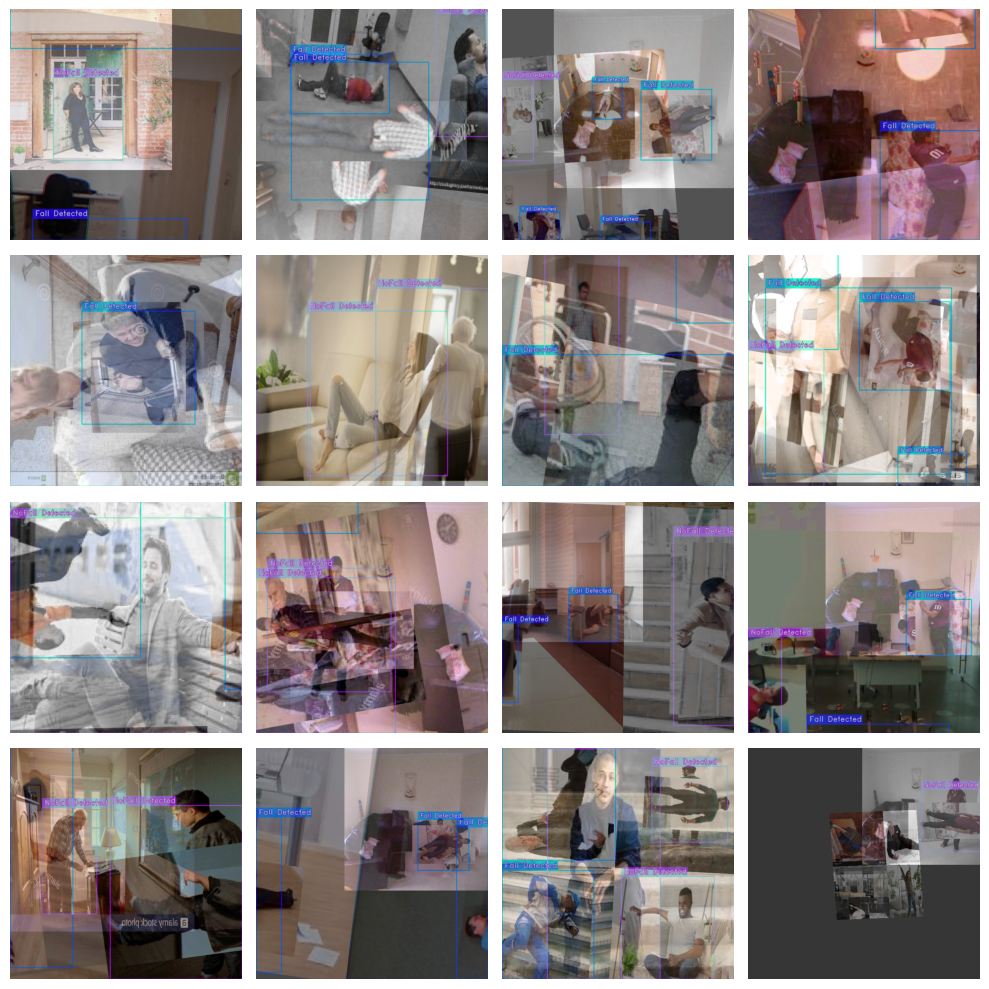

In [16]:
train_data.dataset.plot()

# Model

In [17]:
model = models.get(
    config.MODEL_NAME,
    num_classes=config.NUM_CLASSES,
    pretrained_weights="coco"  # ← agora será carregado do cache local
)


[2025-07-30 00:26:57] WARNING - checkpoint_utils.py - :warning: The pre-trained models provided by SuperGradients may have their own licenses or terms and conditions derived from the dataset used for pre-training.
 It is your responsibility to determine whether you have permission to use the models for your use case.
 The model you have requested was pre-trained on the coco dataset, published under the following terms: https://cocodataset.org/#termsofuse
[2025-07-30 00:26:57] INFO - checkpoint_utils.py - License Notification: YOLO-NAS pre-trained weights are subjected to the specific license terms and conditions detailed in 
https://github.com/Deci-AI/super-gradients/blob/master/LICENSE.YOLONAS.md
By downloading the pre-trained weight files you agree to comply with these terms.
[2025-07-30 00:26:57] INFO - checkpoint_utils.py - Successfully loaded pretrained weights for architecture yolo_nas_l


In [18]:
train_params = {
    # ENABLING SILENT MODE
    "average_best_models":True,
    "warmup_mode": "linear_epoch_step",
    "warmup_initial_lr": 1e-6,
    "lr_warmup_epochs": 3,
    "initial_lr": 5e-4,
    "lr_mode": "cosine",
    "cosine_final_lr_ratio": 0.1,
    "optimizer": "AdamW",
    "optimizer_params": {"weight_decay": 0.0001},
    "zero_weight_decay_on_bias_and_bn": True,
    "ema": True,
    "ema_params": {"decay": 0.9, "decay_type": "threshold"},
    # ONLY TRAINING FOR 10 EPOCHS FOR THIS EXAMPLE NOTEBOOK
    "max_epochs": 30,
    "mixed_precision": True, #mixed precision is not available for CPU 
    "loss": PPYoloELoss(
        use_static_assigner=False,
        # NOTE: num_classes needs to be defined here
        num_classes=config.NUM_CLASSES,
        reg_max=16
    ),
    "valid_metrics_list": [
        DetectionMetrics_050(
            score_thres=0.1,
            top_k_predictions=300,
            # NOTE: num_classes needs to be defined here
            num_cls=config.NUM_CLASSES,
            normalize_targets=True,
            post_prediction_callback=PPYoloEPostPredictionCallback(
                score_threshold=0.01,
                nms_top_k=1000,
                max_predictions=300,
                nms_threshold=0.7
            )
        )
    ],
    "metric_to_watch": 'mAP@0.50'
}

/home/natalia/miniconda3/envs/yolonas_env/lib/python3.10/site-packages/super_gradients/training/losses/ppyolo_loss.py:669: DeprecationWarning: A reg_max argument is not needed for PPYoloE loss anymore. It is deprecated since SG 3.6.0 and will be removed in the SG 3.8.0.You can safely omit this argument as it is not used anymore and we infer it automatically from model's outputs
  warnings.warn(


# Train the model

In [19]:
import torch
import numpy as np

# (1) Registrar classes seguras
torch.serialization.add_safe_globals([
    np.ndarray,
    np.dtype,
    np.core.multiarray._reconstruct
])

# (2) Forçar fallback do torch.load com weights_only=False
_original_torch_load = torch.load

def patched_torch_load(*args, **kwargs):
    kwargs["weights_only"] = False
    return _original_torch_load(*args, **kwargs)

torch.load = patched_torch_load


In [20]:
trainer.train(model=model, 
              training_params=train_params, 
              train_loader=train_data, 
              valid_loader=val_data)

[2025-07-30 00:26:58] INFO - sg_trainer.py - Starting a new run with `run_id=RUN_20250730_002658_098130`
[2025-07-30 00:26:58] INFO - sg_trainer.py - Checkpoints directory: checkpoints/fall_detection/RUN_20250730_002658_098130
[2025-07-30 00:26:58] INFO - sg_trainer.py - Using EMA with params {'decay': 0.9, 'decay_type': 'threshold'}
/home/natalia/miniconda3/envs/yolonas_env/lib/python3.10/site-packages/super_gradients/common/registry/registry.py:72: DeprecationWarning: Object name `linear_epoch_step` is now deprecated. Please replace it with `LinearEpochLRWarmup`.
  warnings.warn(f"Object name `{name}` is now deprecated. Please replace it with `{deprecated_names[name]}`.", DeprecationWarning)
/home/natalia/miniconda3/envs/yolonas_env/lib/python3.10/site-packages/super_gradients/training/utils/optimizer_utils.py:108: DeprecationWarning: initialize_param_groups and update_param_groups usages are deprecated since 3.4.0, will be removed in 3.5.0 and have no effect. 
 Assign different lear

The console stream is now moved to checkpoints/fall_detection/RUN_20250730_002658_098130/console_Jul30_00_26_58.txt


[2025-07-30 00:27:00] INFO - sg_trainer_utils.py - TRAINING PARAMETERS:
    - Mode:                         Single GPU
    - Number of GPUs:               1          (1 available on the machine)
    - Full dataset size:            909        (len(train_set))
    - Batch size per GPU:           16         (batch_size)
    - Batch Accumulate:             1          (batch_accumulate)
    - Total batch size:             16         (num_gpus * batch_size)
    - Effective Batch size:         16         (num_gpus * batch_size * batch_accumulate)
    - Iterations per epoch:         56         (len(train_loader))
    - Gradient updates per epoch:   56         (len(train_loader) / batch_accumulate)
    - Model: YoloNAS_L  (66.91M parameters, 66.91M optimized)
    - Learning Rates and Weight Decays:
      - default: (66.91M parameters). LR: 0.0005 (66.91M parameters) WD: 0.0, (84.69K parameters), WD: 0.0001, (66.82M parameters)

[2025-07-30 00:27:00] INFO - sg_trainer.py - Started training for 3

SUMMARY OF EPOCH 0
├── Train
│   ├── Ppyoloeloss/loss_cls = 2.0814
│   ├── Ppyoloeloss/loss_iou = 0.6744
│   ├── Ppyoloeloss/loss_dfl = 0.8472
│   └── Ppyoloeloss/loss = 3.6029
└── Validation
    ├── Ppyoloeloss/loss_cls = 2.1635
    ├── Ppyoloeloss/loss_iou = 0.56
    ├── Ppyoloeloss/loss_dfl = 0.9161
    ├── Ppyoloeloss/loss = 3.6397
    ├── Precision@0.50 = 0.0
    ├── Recall@0.50 = 0.0
    ├── Map@0.50 = 0.0207
    ├── F1@0.50 = 0.0
    └── Best_score_threshold = 0.04



Train epoch 1: 100%|██████████| 56/56 [02:22<00:00,  2.55s/it, PPYoloELoss/loss=2.79, PPYoloELoss/loss
Validating epoch 1: 100%|██████████| 6/6 [00:02<00:00,  3.00it/s]
[2025-07-30 00:30:38] INFO - base_sg_logger.py - Checkpoint saved in checkpoints/fall_detection/RUN_20250730_002658_098130/ckpt_best.pth
[2025-07-30 00:30:38] INFO - sg_trainer.py - Best checkpoint overriden: validation mAP@0.50: 0.3314988911151886


SUMMARY OF EPOCH 1
├── Train
│   ├── Ppyoloeloss/loss_cls = 1.3847
│   │   ├── Epoch N-1      = 2.0814 (↘ -0.6967)
│   │   └── Best until now = 2.0814 (↘ -0.6967)
│   ├── Ppyoloeloss/loss_iou = 0.5912
│   │   ├── Epoch N-1      = 0.6744 (↘ -0.0831)
│   │   └── Best until now = 0.6744 (↘ -0.0831)
│   ├── Ppyoloeloss/loss_dfl = 0.8111
│   │   ├── Epoch N-1      = 0.8472 (↘ -0.0361)
│   │   └── Best until now = 0.8472 (↘ -0.0361)
│   └── Ppyoloeloss/loss = 2.787
│       ├── Epoch N-1      = 3.6029 (↘ -0.8159)
│       └── Best until now = 3.6029 (↘ -0.8159)
└── Validation
    ├── Ppyoloeloss/loss_cls = 7.6421
    │   ├── Epoch N-1      = 2.1635 (↗ 5.4786)
    │   └── Best until now = 2.1635 (↗ 5.4786)
    ├── Ppyoloeloss/loss_iou = 0.5712
    │   ├── Epoch N-1      = 0.56   (↗ 0.0112)
    │   └── Best until now = 0.56   (↗ 0.0112)
    ├── Ppyoloeloss/loss_dfl = 0.938
    │   ├── Epoch N-1      = 0.9161 (↗ 0.0218)
    │   └── Best until now = 0.9161 (↗ 0.0218)
    ├── Ppyoloeloss/loss = 9.1

Train epoch 2: 100%|██████████| 56/56 [02:40<00:00,  2.87s/it, PPYoloELoss/loss=2.61, PPYoloELoss/loss
Validating epoch 2: 100%|██████████| 6/6 [00:07<00:00,  1.23s/it]


SUMMARY OF EPOCH 2
├── Train
│   ├── Ppyoloeloss/loss_cls = 1.2506
│   │   ├── Epoch N-1      = 1.3847 (↘ -0.134)
│   │   └── Best until now = 1.3847 (↘ -0.134)
│   ├── Ppyoloeloss/loss_iou = 0.5682
│   │   ├── Epoch N-1      = 0.5912 (↘ -0.023)
│   │   └── Best until now = 0.5912 (↘ -0.023)
│   ├── Ppyoloeloss/loss_dfl = 0.7877
│   │   ├── Epoch N-1      = 0.8111 (↘ -0.0234)
│   │   └── Best until now = 0.8111 (↘ -0.0234)
│   └── Ppyoloeloss/loss = 2.6066
│       ├── Epoch N-1      = 2.787  (↘ -0.1804)
│       └── Best until now = 2.787  (↘ -0.1804)
└── Validation
    ├── Ppyoloeloss/loss_cls = 1.8846
    │   ├── Epoch N-1      = 7.6421 (↘ -5.7575)
    │   └── Best until now = 2.1635 (↘ -0.279)
    ├── Ppyoloeloss/loss_iou = 0.6359
    │   ├── Epoch N-1      = 0.5712 (↗ 0.0648)
    │   └── Best until now = 0.56   (↗ 0.076)
    ├── Ppyoloeloss/loss_dfl = 0.9882
    │   ├── Epoch N-1      = 0.938  (↗ 0.0503)
    │   └── Best until now = 0.9161 (↗ 0.0721)
    ├── Ppyoloeloss/loss = 3.508

Train epoch 3: 100%|██████████| 56/56 [02:41<00:00,  2.88s/it, PPYoloELoss/loss=2.58, PPYoloELoss/loss
Validating epoch 3: 100%|██████████| 6/6 [00:07<00:00,  1.23s/it]
[2025-07-30 00:36:35] INFO - base_sg_logger.py - Checkpoint saved in checkpoints/fall_detection/RUN_20250730_002658_098130/ckpt_best.pth
[2025-07-30 00:36:35] INFO - sg_trainer.py - Best checkpoint overriden: validation mAP@0.50: 0.35071495175361633


SUMMARY OF EPOCH 3
├── Train
│   ├── Ppyoloeloss/loss_cls = 1.237
│   │   ├── Epoch N-1      = 1.2506 (↘ -0.0137)
│   │   └── Best until now = 1.2506 (↘ -0.0137)
│   ├── Ppyoloeloss/loss_iou = 0.5616
│   │   ├── Epoch N-1      = 0.5682 (↘ -0.0066)
│   │   └── Best until now = 0.5682 (↘ -0.0066)
│   ├── Ppyoloeloss/loss_dfl = 0.7855
│   │   ├── Epoch N-1      = 0.7877 (↘ -0.0022)
│   │   └── Best until now = 0.7877 (↘ -0.0022)
│   └── Ppyoloeloss/loss = 2.5841
│       ├── Epoch N-1      = 2.6066 (↘ -0.0225)
│       └── Best until now = 2.6066 (↘ -0.0225)
└── Validation
    ├── Ppyoloeloss/loss_cls = 1.5158
    │   ├── Epoch N-1      = 1.8846 (↘ -0.3688)
    │   └── Best until now = 1.8846 (↘ -0.3688)
    ├── Ppyoloeloss/loss_iou = 0.5623
    │   ├── Epoch N-1      = 0.6359 (↘ -0.0737)
    │   └── Best until now = 0.56   (↗ 0.0023)
    ├── Ppyoloeloss/loss_dfl = 0.9059
    │   ├── Epoch N-1      = 0.9882 (↘ -0.0823)
    │   └── Best until now = 0.9161 (↘ -0.0103)
    ├── Ppyoloeloss/loss

Train epoch 4: 100%|██████████| 56/56 [02:13<00:00,  2.38s/it, PPYoloELoss/loss=2.53, PPYoloELoss/loss
Validating epoch 4: 100%|██████████| 6/6 [00:08<00:00,  1.36s/it]
[2025-07-30 00:39:17] INFO - base_sg_logger.py - Checkpoint saved in checkpoints/fall_detection/RUN_20250730_002658_098130/ckpt_best.pth
[2025-07-30 00:39:17] INFO - sg_trainer.py - Best checkpoint overriden: validation mAP@0.50: 0.3607277572154999


SUMMARY OF EPOCH 4
├── Train
│   ├── Ppyoloeloss/loss_cls = 1.211
│   │   ├── Epoch N-1      = 1.237  (↘ -0.026)
│   │   └── Best until now = 1.237  (↘ -0.026)
│   ├── Ppyoloeloss/loss_iou = 0.5492
│   │   ├── Epoch N-1      = 0.5616 (↘ -0.0125)
│   │   └── Best until now = 0.5616 (↘ -0.0125)
│   ├── Ppyoloeloss/loss_dfl = 0.7727
│   │   ├── Epoch N-1      = 0.7855 (↘ -0.0128)
│   │   └── Best until now = 0.7855 (↘ -0.0128)
│   └── Ppyoloeloss/loss = 2.5329
│       ├── Epoch N-1      = 2.5841 (↘ -0.0512)
│       └── Best until now = 2.5841 (↘ -0.0512)
└── Validation
    ├── Ppyoloeloss/loss_cls = 1.6729
    │   ├── Epoch N-1      = 1.5158 (↗ 0.1571)
    │   └── Best until now = 1.5158 (↗ 0.1571)
    ├── Ppyoloeloss/loss_iou = 0.5678
    │   ├── Epoch N-1      = 0.5623 (↗ 0.0055)
    │   └── Best until now = 0.56   (↗ 0.0078)
    ├── Ppyoloeloss/loss_dfl = 0.9665
    │   ├── Epoch N-1      = 0.9059 (↗ 0.0606)
    │   └── Best until now = 0.9059 (↗ 0.0606)
    ├── Ppyoloeloss/loss = 3.20

Train epoch 5: 100%|██████████| 56/56 [02:17<00:00,  2.45s/it, PPYoloELoss/loss=2.46, PPYoloELoss/loss
Validating epoch 5: 100%|██████████| 6/6 [00:06<00:00,  1.01s/it]


SUMMARY OF EPOCH 5
├── Train
│   ├── Ppyoloeloss/loss_cls = 1.1907
│   │   ├── Epoch N-1      = 1.211  (↘ -0.0203)
│   │   └── Best until now = 1.211  (↘ -0.0203)
│   ├── Ppyoloeloss/loss_iou = 0.5234
│   │   ├── Epoch N-1      = 0.5492 (↘ -0.0257)
│   │   └── Best until now = 0.5492 (↘ -0.0257)
│   ├── Ppyoloeloss/loss_dfl = 0.746
│   │   ├── Epoch N-1      = 0.7727 (↘ -0.0267)
│   │   └── Best until now = 0.7727 (↘ -0.0267)
│   └── Ppyoloeloss/loss = 2.4601
│       ├── Epoch N-1      = 2.5329 (↘ -0.0728)
│       └── Best until now = 2.5329 (↘ -0.0728)
└── Validation
    ├── Ppyoloeloss/loss_cls = 1.3639
    │   ├── Epoch N-1      = 1.6729 (↘ -0.309)
    │   └── Best until now = 1.5158 (↘ -0.1519)
    ├── Ppyoloeloss/loss_iou = 0.5928
    │   ├── Epoch N-1      = 0.5678 (↗ 0.025)
    │   └── Best until now = 0.56   (↗ 0.0328)
    ├── Ppyoloeloss/loss_dfl = 0.8996
    │   ├── Epoch N-1      = 0.9665 (↘ -0.0668)
    │   └── Best until now = 0.9059 (↘ -0.0062)
    ├── Ppyoloeloss/loss = 

Train epoch 6: 100%|██████████| 56/56 [02:19<00:00,  2.48s/it, PPYoloELoss/loss=2.44, PPYoloELoss/loss
Validating epoch 6: 100%|██████████| 6/6 [00:02<00:00,  2.25it/s]
[2025-07-30 00:44:34] INFO - base_sg_logger.py - Checkpoint saved in checkpoints/fall_detection/RUN_20250730_002658_098130/ckpt_best.pth
[2025-07-30 00:44:34] INFO - sg_trainer.py - Best checkpoint overriden: validation mAP@0.50: 0.44502341747283936


SUMMARY OF EPOCH 6
├── Train
│   ├── Ppyoloeloss/loss_cls = 1.1858
│   │   ├── Epoch N-1      = 1.1907 (↘ -0.0048)
│   │   └── Best until now = 1.1907 (↘ -0.0048)
│   ├── Ppyoloeloss/loss_iou = 0.5192
│   │   ├── Epoch N-1      = 0.5234 (↘ -0.0043)
│   │   └── Best until now = 0.5234 (↘ -0.0043)
│   ├── Ppyoloeloss/loss_dfl = 0.7345
│   │   ├── Epoch N-1      = 0.746  (↘ -0.0116)
│   │   └── Best until now = 0.746  (↘ -0.0116)
│   └── Ppyoloeloss/loss = 2.4395
│       ├── Epoch N-1      = 2.4601 (↘ -0.0207)
│       └── Best until now = 2.4601 (↘ -0.0207)
└── Validation
    ├── Ppyoloeloss/loss_cls = 1.4292
    │   ├── Epoch N-1      = 1.3639 (↗ 0.0653)
    │   └── Best until now = 1.3639 (↗ 0.0653)
    ├── Ppyoloeloss/loss_iou = 0.5328
    │   ├── Epoch N-1      = 0.5928 (↘ -0.06)
    │   └── Best until now = 0.56   (↘ -0.0272)
    ├── Ppyoloeloss/loss_dfl = 0.8854
    │   ├── Epoch N-1      = 0.8996 (↘ -0.0143)
    │   └── Best until now = 0.8996 (↘ -0.0143)
    ├── Ppyoloeloss/loss =

Train epoch 7: 100%|██████████| 56/56 [02:22<00:00,  2.55s/it, PPYoloELoss/loss=2.36, PPYoloELoss/loss
Validating epoch 7: 100%|██████████| 6/6 [00:07<00:00,  1.27s/it]
[2025-07-30 00:47:25] INFO - base_sg_logger.py - Checkpoint saved in checkpoints/fall_detection/RUN_20250730_002658_098130/ckpt_best.pth
[2025-07-30 00:47:25] INFO - sg_trainer.py - Best checkpoint overriden: validation mAP@0.50: 0.5456252098083496


SUMMARY OF EPOCH 7
├── Train
│   ├── Ppyoloeloss/loss_cls = 1.1505
│   │   ├── Epoch N-1      = 1.1858 (↘ -0.0353)
│   │   └── Best until now = 1.1858 (↘ -0.0353)
│   ├── Ppyoloeloss/loss_iou = 0.494
│   │   ├── Epoch N-1      = 0.5192 (↘ -0.0252)
│   │   └── Best until now = 0.5192 (↘ -0.0252)
│   ├── Ppyoloeloss/loss_dfl = 0.7134
│   │   ├── Epoch N-1      = 0.7345 (↘ -0.0211)
│   │   └── Best until now = 0.7345 (↘ -0.0211)
│   └── Ppyoloeloss/loss = 2.3579
│       ├── Epoch N-1      = 2.4395 (↘ -0.0816)
│       └── Best until now = 2.4395 (↘ -0.0816)
└── Validation
    ├── Ppyoloeloss/loss_cls = 1.3083
    │   ├── Epoch N-1      = 1.4292 (↘ -0.1209)
    │   └── Best until now = 1.3639 (↘ -0.0557)
    ├── Ppyoloeloss/loss_iou = 0.5035
    │   ├── Epoch N-1      = 0.5328 (↘ -0.0293)
    │   └── Best until now = 0.5328 (↘ -0.0293)
    ├── Ppyoloeloss/loss_dfl = 0.8147
    │   ├── Epoch N-1      = 0.8854 (↘ -0.0706)
    │   └── Best until now = 0.8854 (↘ -0.0706)
    ├── Ppyoloeloss/los

Train epoch 8: 100%|██████████| 56/56 [03:05<00:00,  3.32s/it, PPYoloELoss/loss=2.32, PPYoloELoss/loss
Validating epoch 8: 100%|██████████| 6/6 [00:07<00:00,  1.29s/it]


SUMMARY OF EPOCH 8
├── Train
│   ├── Ppyoloeloss/loss_cls = 1.1291
│   │   ├── Epoch N-1      = 1.1505 (↘ -0.0214)
│   │   └── Best until now = 1.1505 (↘ -0.0214)
│   ├── Ppyoloeloss/loss_iou = 0.4867
│   │   ├── Epoch N-1      = 0.494  (↘ -0.0073)
│   │   └── Best until now = 0.494  (↘ -0.0073)
│   ├── Ppyoloeloss/loss_dfl = 0.7045
│   │   ├── Epoch N-1      = 0.7134 (↘ -0.0089)
│   │   └── Best until now = 0.7134 (↘ -0.0089)
│   └── Ppyoloeloss/loss = 2.3203
│       ├── Epoch N-1      = 2.3579 (↘ -0.0376)
│       └── Best until now = 2.3579 (↘ -0.0376)
└── Validation
    ├── Ppyoloeloss/loss_cls = 1.3257
    │   ├── Epoch N-1      = 1.3083 (↗ 0.0174)
    │   └── Best until now = 1.3083 (↗ 0.0174)
    ├── Ppyoloeloss/loss_iou = 0.5536
    │   ├── Epoch N-1      = 0.5035 (↗ 0.0501)
    │   └── Best until now = 0.5035 (↗ 0.0501)
    ├── Ppyoloeloss/loss_dfl = 0.884
    │   ├── Epoch N-1      = 0.8147 (↗ 0.0693)
    │   └── Best until now = 0.8147 (↗ 0.0693)
    ├── Ppyoloeloss/loss = 2.

Train epoch 9: 100%|██████████| 56/56 [02:14<00:00,  2.40s/it, PPYoloELoss/loss=2.29, PPYoloELoss/loss
Validating epoch 9: 100%|██████████| 6/6 [00:04<00:00,  1.34it/s]


SUMMARY OF EPOCH 9
├── Train
│   ├── Ppyoloeloss/loss_cls = 1.1178
│   │   ├── Epoch N-1      = 1.1291 (↘ -0.0113)
│   │   └── Best until now = 1.1291 (↘ -0.0113)
│   ├── Ppyoloeloss/loss_iou = 0.4765
│   │   ├── Epoch N-1      = 0.4867 (↘ -0.0102)
│   │   └── Best until now = 0.4867 (↘ -0.0102)
│   ├── Ppyoloeloss/loss_dfl = 0.6995
│   │   ├── Epoch N-1      = 0.7045 (↘ -0.005)
│   │   └── Best until now = 0.7045 (↘ -0.005)
│   └── Ppyoloeloss/loss = 2.2938
│       ├── Epoch N-1      = 2.3203 (↘ -0.0265)
│       └── Best until now = 2.3203 (↘ -0.0265)
└── Validation
    ├── Ppyoloeloss/loss_cls = 1.3267
    │   ├── Epoch N-1      = 1.3257 (↗ 0.001)
    │   └── Best until now = 1.3083 (↗ 0.0184)
    ├── Ppyoloeloss/loss_iou = 0.5365
    │   ├── Epoch N-1      = 0.5536 (↘ -0.0171)
    │   └── Best until now = 0.5035 (↗ 0.0329)
    ├── Ppyoloeloss/loss_dfl = 0.8546
    │   ├── Epoch N-1      = 0.884  (↘ -0.0294)
    │   └── Best until now = 0.8147 (↗ 0.0399)
    ├── Ppyoloeloss/loss = 2.

Train epoch 10: 100%|██████████| 56/56 [03:33<00:00,  3.82s/it, PPYoloELoss/loss=2.28, PPYoloELoss/los
Validating epoch 10: 100%|██████████| 6/6 [00:06<00:00,  1.05s/it]
[2025-07-30 00:58:04] INFO - base_sg_logger.py - Checkpoint saved in checkpoints/fall_detection/RUN_20250730_002658_098130/ckpt_best.pth
[2025-07-30 00:58:04] INFO - sg_trainer.py - Best checkpoint overriden: validation mAP@0.50: 0.5855172872543335


SUMMARY OF EPOCH 10
├── Train
│   ├── Ppyoloeloss/loss_cls = 1.118
│   │   ├── Epoch N-1      = 1.1178 (↗ 0.0003)
│   │   └── Best until now = 1.1178 (↗ 0.0003)
│   ├── Ppyoloeloss/loss_iou = 0.4713
│   │   ├── Epoch N-1      = 0.4765 (↘ -0.0052)
│   │   └── Best until now = 0.4765 (↘ -0.0052)
│   ├── Ppyoloeloss/loss_dfl = 0.6862
│   │   ├── Epoch N-1      = 0.6995 (↘ -0.0133)
│   │   └── Best until now = 0.6995 (↘ -0.0133)
│   └── Ppyoloeloss/loss = 2.2755
│       ├── Epoch N-1      = 2.2938 (↘ -0.0182)
│       └── Best until now = 2.2938 (↘ -0.0182)
└── Validation
    ├── Ppyoloeloss/loss_cls = 1.3166
    │   ├── Epoch N-1      = 1.3267 (↘ -0.01)
    │   └── Best until now = 1.3083 (↗ 0.0084)
    ├── Ppyoloeloss/loss_iou = 0.5276
    │   ├── Epoch N-1      = 0.5365 (↘ -0.0089)
    │   └── Best until now = 0.5035 (↗ 0.024)
    ├── Ppyoloeloss/loss_dfl = 0.8736
    │   ├── Epoch N-1      = 0.8546 (↗ 0.019)
    │   └── Best until now = 0.8147 (↗ 0.0589)
    ├── Ppyoloeloss/loss = 2.717

Train epoch 11: 100%|██████████| 56/56 [02:30<00:00,  2.68s/it, PPYoloELoss/loss=2.26, PPYoloELoss/los
Validating epoch 11: 100%|██████████| 6/6 [00:02<00:00,  2.40it/s]


SUMMARY OF EPOCH 11
├── Train
│   ├── Ppyoloeloss/loss_cls = 1.113
│   │   ├── Epoch N-1      = 1.118  (↘ -0.005)
│   │   └── Best until now = 1.1178 (↘ -0.0047)
│   ├── Ppyoloeloss/loss_iou = 0.4588
│   │   ├── Epoch N-1      = 0.4713 (↘ -0.0125)
│   │   └── Best until now = 0.4713 (↘ -0.0125)
│   ├── Ppyoloeloss/loss_dfl = 0.6836
│   │   ├── Epoch N-1      = 0.6862 (↘ -0.0026)
│   │   └── Best until now = 0.6862 (↘ -0.0026)
│   └── Ppyoloeloss/loss = 2.2554
│       ├── Epoch N-1      = 2.2755 (↘ -0.0201)
│       └── Best until now = 2.2755 (↘ -0.0201)
└── Validation
    ├── Ppyoloeloss/loss_cls = 1.3279
    │   ├── Epoch N-1      = 1.3166 (↗ 0.0113)
    │   └── Best until now = 1.3083 (↗ 0.0197)
    ├── Ppyoloeloss/loss_iou = 0.5175
    │   ├── Epoch N-1      = 0.5276 (↘ -0.0101)
    │   └── Best until now = 0.5035 (↗ 0.0139)
    ├── Ppyoloeloss/loss_dfl = 0.8757
    │   ├── Epoch N-1      = 0.8736 (↗ 0.0021)
    │   └── Best until now = 0.8147 (↗ 0.061)
    ├── Ppyoloeloss/loss = 2.

Train epoch 12: 100%|██████████| 56/56 [02:31<00:00,  2.71s/it, PPYoloELoss/loss=2.21, PPYoloELoss/los
Validating epoch 12: 100%|██████████| 6/6 [00:02<00:00,  2.88it/s]


SUMMARY OF EPOCH 12
├── Train
│   ├── Ppyoloeloss/loss_cls = 1.0666
│   │   ├── Epoch N-1      = 1.113  (↘ -0.0464)
│   │   └── Best until now = 1.113  (↘ -0.0464)
│   ├── Ppyoloeloss/loss_iou = 0.4625
│   │   ├── Epoch N-1      = 0.4588 (↗ 0.0037)
│   │   └── Best until now = 0.4588 (↗ 0.0037)
│   ├── Ppyoloeloss/loss_dfl = 0.6766
│   │   ├── Epoch N-1      = 0.6836 (↘ -0.007)
│   │   └── Best until now = 0.6836 (↘ -0.007)
│   └── Ppyoloeloss/loss = 2.2057
│       ├── Epoch N-1      = 2.2554 (↘ -0.0497)
│       └── Best until now = 2.2554 (↘ -0.0497)
└── Validation
    ├── Ppyoloeloss/loss_cls = 1.2736
    │   ├── Epoch N-1      = 1.3279 (↘ -0.0543)
    │   └── Best until now = 1.3083 (↘ -0.0347)
    ├── Ppyoloeloss/loss_iou = 0.5277
    │   ├── Epoch N-1      = 0.5175 (↗ 0.0102)
    │   └── Best until now = 0.5035 (↗ 0.0242)
    ├── Ppyoloeloss/loss_dfl = 0.8326
    │   ├── Epoch N-1      = 0.8757 (↘ -0.0432)
    │   └── Best until now = 0.8147 (↗ 0.0179)
    ├── Ppyoloeloss/loss = 2

Train epoch 13: 100%|██████████| 56/56 [02:06<00:00,  2.26s/it, PPYoloELoss/loss=2.18, PPYoloELoss/los
Validating epoch 13: 100%|██████████| 6/6 [00:02<00:00,  2.19it/s]
[2025-07-30 01:06:45] INFO - base_sg_logger.py - Checkpoint saved in checkpoints/fall_detection/RUN_20250730_002658_098130/ckpt_best.pth
[2025-07-30 01:06:45] INFO - sg_trainer.py - Best checkpoint overriden: validation mAP@0.50: 0.604770839214325


SUMMARY OF EPOCH 13
├── Train
│   ├── Ppyoloeloss/loss_cls = 1.0626
│   │   ├── Epoch N-1      = 1.0666 (↘ -0.0041)
│   │   └── Best until now = 1.0666 (↘ -0.0041)
│   ├── Ppyoloeloss/loss_iou = 0.4534
│   │   ├── Epoch N-1      = 0.4625 (↘ -0.0091)
│   │   └── Best until now = 0.4588 (↘ -0.0054)
│   ├── Ppyoloeloss/loss_dfl = 0.6679
│   │   ├── Epoch N-1      = 0.6766 (↘ -0.0086)
│   │   └── Best until now = 0.6766 (↘ -0.0086)
│   └── Ppyoloeloss/loss = 2.1839
│       ├── Epoch N-1      = 2.2057 (↘ -0.0218)
│       └── Best until now = 2.2057 (↘ -0.0218)
└── Validation
    ├── Ppyoloeloss/loss_cls = 1.2122
    │   ├── Epoch N-1      = 1.2736 (↘ -0.0614)
    │   └── Best until now = 1.2736 (↘ -0.0614)
    ├── Ppyoloeloss/loss_iou = 0.4879
    │   ├── Epoch N-1      = 0.5277 (↘ -0.0398)
    │   └── Best until now = 0.5035 (↘ -0.0156)
    ├── Ppyoloeloss/loss_dfl = 0.8039
    │   ├── Epoch N-1      = 0.8326 (↘ -0.0287)
    │   └── Best until now = 0.8147 (↘ -0.0108)
    ├── Ppyoloeloss/l

Train epoch 14: 100%|██████████| 56/56 [01:43<00:00,  1.85s/it, PPYoloELoss/loss=2.16, PPYoloELoss/los
Validating epoch 14: 100%|██████████| 6/6 [00:02<00:00,  2.89it/s]


SUMMARY OF EPOCH 14
├── Train
│   ├── Ppyoloeloss/loss_cls = 1.056
│   │   ├── Epoch N-1      = 1.0626 (↘ -0.0066)
│   │   └── Best until now = 1.0626 (↘ -0.0066)
│   ├── Ppyoloeloss/loss_iou = 0.4455
│   │   ├── Epoch N-1      = 0.4534 (↘ -0.0079)
│   │   └── Best until now = 0.4534 (↘ -0.0079)
│   ├── Ppyoloeloss/loss_dfl = 0.6589
│   │   ├── Epoch N-1      = 0.6679 (↘ -0.009)
│   │   └── Best until now = 0.6679 (↘ -0.009)
│   └── Ppyoloeloss/loss = 2.1604
│       ├── Epoch N-1      = 2.1839 (↘ -0.0235)
│       └── Best until now = 2.1839 (↘ -0.0235)
└── Validation
    ├── Ppyoloeloss/loss_cls = 1.2665
    │   ├── Epoch N-1      = 1.2122 (↗ 0.0542)
    │   └── Best until now = 1.2122 (↗ 0.0542)
    ├── Ppyoloeloss/loss_iou = 0.5196
    │   ├── Epoch N-1      = 0.4879 (↗ 0.0317)
    │   └── Best until now = 0.4879 (↗ 0.0317)
    ├── Ppyoloeloss/loss_dfl = 0.8691
    │   ├── Epoch N-1      = 0.8039 (↗ 0.0652)
    │   └── Best until now = 0.8039 (↗ 0.0652)
    ├── Ppyoloeloss/loss = 2.6

Train epoch 15: 100%|██████████| 56/56 [01:58<00:00,  2.12s/it, PPYoloELoss/loss=2.12, PPYoloELoss/los
Validating epoch 15: 100%|██████████| 6/6 [00:02<00:00,  2.98it/s]
[2025-07-30 01:11:24] INFO - base_sg_logger.py - Checkpoint saved in checkpoints/fall_detection/RUN_20250730_002658_098130/ckpt_best.pth
[2025-07-30 01:11:24] INFO - sg_trainer.py - Best checkpoint overriden: validation mAP@0.50: 0.6358447074890137


SUMMARY OF EPOCH 15
├── Train
│   ├── Ppyoloeloss/loss_cls = 1.0402
│   │   ├── Epoch N-1      = 1.056  (↘ -0.0157)
│   │   └── Best until now = 1.056  (↘ -0.0157)
│   ├── Ppyoloeloss/loss_iou = 0.4303
│   │   ├── Epoch N-1      = 0.4455 (↘ -0.0152)
│   │   └── Best until now = 0.4455 (↘ -0.0152)
│   ├── Ppyoloeloss/loss_dfl = 0.6503
│   │   ├── Epoch N-1      = 0.6589 (↘ -0.0087)
│   │   └── Best until now = 0.6589 (↘ -0.0087)
│   └── Ppyoloeloss/loss = 2.1208
│       ├── Epoch N-1      = 2.1604 (↘ -0.0396)
│       └── Best until now = 2.1604 (↘ -0.0396)
└── Validation
    ├── Ppyoloeloss/loss_cls = 1.2135
    │   ├── Epoch N-1      = 1.2665 (↘ -0.053)
    │   └── Best until now = 1.2122 (↗ 0.0013)
    ├── Ppyoloeloss/loss_iou = 0.5074
    │   ├── Epoch N-1      = 0.5196 (↘ -0.0122)
    │   └── Best until now = 0.4879 (↗ 0.0196)
    ├── Ppyoloeloss/loss_dfl = 0.8454
    │   ├── Epoch N-1      = 0.8691 (↘ -0.0236)
    │   └── Best until now = 0.8039 (↗ 0.0416)
    ├── Ppyoloeloss/loss 

Train epoch 16: 100%|██████████| 56/56 [01:42<00:00,  1.82s/it, PPYoloELoss/loss=2.12, PPYoloELoss/los
Validating epoch 16: 100%|██████████| 6/6 [00:02<00:00,  2.44it/s]


SUMMARY OF EPOCH 16
├── Train
│   ├── Ppyoloeloss/loss_cls = 1.0327
│   │   ├── Epoch N-1      = 1.0402 (↘ -0.0076)
│   │   └── Best until now = 1.0402 (↘ -0.0076)
│   ├── Ppyoloeloss/loss_iou = 0.4352
│   │   ├── Epoch N-1      = 0.4303 (↗ 0.005)
│   │   └── Best until now = 0.4303 (↗ 0.005)
│   ├── Ppyoloeloss/loss_dfl = 0.6504
│   │   ├── Epoch N-1      = 0.6503 (↗ 0.0002)
│   │   └── Best until now = 0.6503 (↗ 0.0002)
│   └── Ppyoloeloss/loss = 2.1183
│       ├── Epoch N-1      = 2.1208 (↘ -0.0024)
│       └── Best until now = 2.1208 (↘ -0.0024)
└── Validation
    ├── Ppyoloeloss/loss_cls = 1.2168
    │   ├── Epoch N-1      = 1.2135 (↗ 0.0033)
    │   └── Best until now = 1.2122 (↗ 0.0045)
    ├── Ppyoloeloss/loss_iou = 0.5337
    │   ├── Epoch N-1      = 0.5074 (↗ 0.0263)
    │   └── Best until now = 0.4879 (↗ 0.0458)
    ├── Ppyoloeloss/loss_dfl = 0.8686
    │   ├── Epoch N-1      = 0.8454 (↗ 0.0232)
    │   └── Best until now = 0.8039 (↗ 0.0647)
    ├── Ppyoloeloss/loss = 2.6191

Train epoch 17: 100%|██████████| 56/56 [01:31<00:00,  1.63s/it, PPYoloELoss/loss=2.07, PPYoloELoss/los
Validating epoch 17: 100%|██████████| 6/6 [00:02<00:00,  2.90it/s]


SUMMARY OF EPOCH 17
├── Train
│   ├── Ppyoloeloss/loss_cls = 1.0156
│   │   ├── Epoch N-1      = 1.0327 (↘ -0.017)
│   │   └── Best until now = 1.0327 (↘ -0.017)
│   ├── Ppyoloeloss/loss_iou = 0.4183
│   │   ├── Epoch N-1      = 0.4352 (↘ -0.0169)
│   │   └── Best until now = 0.4303 (↘ -0.012)
│   ├── Ppyoloeloss/loss_dfl = 0.6327
│   │   ├── Epoch N-1      = 0.6504 (↘ -0.0177)
│   │   └── Best until now = 0.6503 (↘ -0.0175)
│   └── Ppyoloeloss/loss = 2.0666
│       ├── Epoch N-1      = 2.1183 (↘ -0.0517)
│       └── Best until now = 2.1183 (↘ -0.0517)
└── Validation
    ├── Ppyoloeloss/loss_cls = 1.2614
    │   ├── Epoch N-1      = 1.2168 (↗ 0.0446)
    │   └── Best until now = 1.2122 (↗ 0.0492)
    ├── Ppyoloeloss/loss_iou = 0.4867
    │   ├── Epoch N-1      = 0.5337 (↘ -0.047)
    │   └── Best until now = 0.4879 (↘ -0.0012)
    ├── Ppyoloeloss/loss_dfl = 0.8144
    │   ├── Epoch N-1      = 0.8686 (↘ -0.0542)
    │   └── Best until now = 0.8039 (↗ 0.0105)
    ├── Ppyoloeloss/loss = 2

Train epoch 18: 100%|██████████| 56/56 [02:21<00:00,  2.53s/it, PPYoloELoss/loss=2.05, PPYoloELoss/los
Validating epoch 18: 100%|██████████| 6/6 [00:02<00:00,  2.80it/s]
[2025-07-30 01:18:33] INFO - base_sg_logger.py - Checkpoint saved in checkpoints/fall_detection/RUN_20250730_002658_098130/ckpt_best.pth
[2025-07-30 01:18:33] INFO - sg_trainer.py - Best checkpoint overriden: validation mAP@0.50: 0.6935383677482605


SUMMARY OF EPOCH 18
├── Train
│   ├── Ppyoloeloss/loss_cls = 1.0063
│   │   ├── Epoch N-1      = 1.0156 (↘ -0.0093)
│   │   └── Best until now = 1.0156 (↘ -0.0093)
│   ├── Ppyoloeloss/loss_iou = 0.4146
│   │   ├── Epoch N-1      = 0.4183 (↘ -0.0037)
│   │   └── Best until now = 0.4183 (↘ -0.0037)
│   ├── Ppyoloeloss/loss_dfl = 0.6294
│   │   ├── Epoch N-1      = 0.6327 (↘ -0.0033)
│   │   └── Best until now = 0.6327 (↘ -0.0033)
│   └── Ppyoloeloss/loss = 2.0504
│       ├── Epoch N-1      = 2.0666 (↘ -0.0163)
│       └── Best until now = 2.0666 (↘ -0.0163)
└── Validation
    ├── Ppyoloeloss/loss_cls = 1.1287
    │   ├── Epoch N-1      = 1.2614 (↘ -0.1327)
    │   └── Best until now = 1.2122 (↘ -0.0835)
    ├── Ppyoloeloss/loss_iou = 0.4973
    │   ├── Epoch N-1      = 0.4867 (↗ 0.0106)
    │   └── Best until now = 0.4867 (↗ 0.0106)
    ├── Ppyoloeloss/loss_dfl = 0.8028
    │   ├── Epoch N-1      = 0.8144 (↘ -0.0116)
    │   └── Best until now = 0.8039 (↘ -0.001)
    ├── Ppyoloeloss/loss

Train epoch 19: 100%|██████████| 56/56 [01:31<00:00,  1.64s/it, PPYoloELoss/loss=1.99, PPYoloELoss/los
Validating epoch 19: 100%|██████████| 6/6 [00:06<00:00,  1.12s/it]
[2025-07-30 01:20:50] INFO - base_sg_logger.py - Checkpoint saved in checkpoints/fall_detection/RUN_20250730_002658_098130/ckpt_best.pth
[2025-07-30 01:20:50] INFO - sg_trainer.py - Best checkpoint overriden: validation mAP@0.50: 0.7420180439949036


SUMMARY OF EPOCH 19
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.9667
│   │   ├── Epoch N-1      = 1.0063 (↘ -0.0396)
│   │   └── Best until now = 1.0063 (↘ -0.0396)
│   ├── Ppyoloeloss/loss_iou = 0.4057
│   │   ├── Epoch N-1      = 0.4146 (↘ -0.009)
│   │   └── Best until now = 0.4146 (↘ -0.009)
│   ├── Ppyoloeloss/loss_dfl = 0.6203
│   │   ├── Epoch N-1      = 0.6294 (↘ -0.0091)
│   │   └── Best until now = 0.6294 (↘ -0.0091)
│   └── Ppyoloeloss/loss = 1.9926
│       ├── Epoch N-1      = 2.0504 (↘ -0.0578)
│       └── Best until now = 2.0504 (↘ -0.0578)
└── Validation
    ├── Ppyoloeloss/loss_cls = 1.0554
    │   ├── Epoch N-1      = 1.1287 (↘ -0.0733)
    │   └── Best until now = 1.1287 (↘ -0.0733)
    ├── Ppyoloeloss/loss_iou = 0.4906
    │   ├── Epoch N-1      = 0.4973 (↘ -0.0068)
    │   └── Best until now = 0.4867 (↗ 0.0039)
    ├── Ppyoloeloss/loss_dfl = 0.7991
    │   ├── Epoch N-1      = 0.8028 (↘ -0.0037)
    │   └── Best until now = 0.8028 (↘ -0.0037)
    ├── Ppyoloeloss/loss

Train epoch 20: 100%|██████████| 56/56 [01:50<00:00,  1.97s/it, PPYoloELoss/loss=1.97, PPYoloELoss/los
Validating epoch 20: 100%|██████████| 6/6 [00:06<00:00,  1.05s/it]


SUMMARY OF EPOCH 20
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.9602
│   │   ├── Epoch N-1      = 0.9667 (↘ -0.0065)
│   │   └── Best until now = 0.9667 (↘ -0.0065)
│   ├── Ppyoloeloss/loss_iou = 0.397
│   │   ├── Epoch N-1      = 0.4057 (↘ -0.0086)
│   │   └── Best until now = 0.4057 (↘ -0.0086)
│   ├── Ppyoloeloss/loss_dfl = 0.6095
│   │   ├── Epoch N-1      = 0.6203 (↘ -0.0108)
│   │   └── Best until now = 0.6203 (↘ -0.0108)
│   └── Ppyoloeloss/loss = 1.9667
│       ├── Epoch N-1      = 1.9926 (↘ -0.0259)
│       └── Best until now = 1.9926 (↘ -0.0259)
└── Validation
    ├── Ppyoloeloss/loss_cls = 1.0489
    │   ├── Epoch N-1      = 1.0554 (↘ -0.0065)
    │   └── Best until now = 1.0554 (↘ -0.0065)
    ├── Ppyoloeloss/loss_iou = 0.5086
    │   ├── Epoch N-1      = 0.4906 (↗ 0.0181)
    │   └── Best until now = 0.4867 (↗ 0.0219)
    ├── Ppyoloeloss/loss_dfl = 0.8341
    │   ├── Epoch N-1      = 0.7991 (↗ 0.035)
    │   └── Best until now = 0.7991 (↗ 0.035)
    ├── Ppyoloeloss/loss = 2

Train epoch 21: 100%|██████████| 56/56 [01:53<00:00,  2.02s/it, PPYoloELoss/loss=1.95, PPYoloELoss/los
Validating epoch 21: 100%|██████████| 6/6 [00:03<00:00,  1.58it/s]


SUMMARY OF EPOCH 21
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.9588
│   │   ├── Epoch N-1      = 0.9602 (↘ -0.0013)
│   │   └── Best until now = 0.9602 (↘ -0.0013)
│   ├── Ppyoloeloss/loss_iou = 0.389
│   │   ├── Epoch N-1      = 0.397  (↘ -0.008)
│   │   └── Best until now = 0.397  (↘ -0.008)
│   ├── Ppyoloeloss/loss_dfl = 0.6023
│   │   ├── Epoch N-1      = 0.6095 (↘ -0.0071)
│   │   └── Best until now = 0.6095 (↘ -0.0071)
│   └── Ppyoloeloss/loss = 1.9502
│       ├── Epoch N-1      = 1.9667 (↘ -0.0165)
│       └── Best until now = 1.9667 (↘ -0.0165)
└── Validation
    ├── Ppyoloeloss/loss_cls = 1.0925
    │   ├── Epoch N-1      = 1.0489 (↗ 0.0436)
    │   └── Best until now = 1.0489 (↗ 0.0436)
    ├── Ppyoloeloss/loss_iou = 0.486
    │   ├── Epoch N-1      = 0.5086 (↘ -0.0226)
    │   └── Best until now = 0.4867 (↘ -0.0007)
    ├── Ppyoloeloss/loss_dfl = 0.7908
    │   ├── Epoch N-1      = 0.8341 (↘ -0.0432)
    │   └── Best until now = 0.7991 (↘ -0.0083)
    ├── Ppyoloeloss/loss = 

Train epoch 22: 100%|██████████| 56/56 [01:06<00:00,  1.20s/it, PPYoloELoss/loss=1.91, PPYoloELoss/los
Validating epoch 22: 100%|██████████| 6/6 [00:02<00:00,  2.75it/s]
[2025-07-30 01:27:00] INFO - base_sg_logger.py - Checkpoint saved in checkpoints/fall_detection/RUN_20250730_002658_098130/ckpt_best.pth
[2025-07-30 01:27:00] INFO - sg_trainer.py - Best checkpoint overriden: validation mAP@0.50: 0.7631716728210449


SUMMARY OF EPOCH 22
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.941
│   │   ├── Epoch N-1      = 0.9588 (↘ -0.0179)
│   │   └── Best until now = 0.9588 (↘ -0.0179)
│   ├── Ppyoloeloss/loss_iou = 0.379
│   │   ├── Epoch N-1      = 0.389  (↘ -0.01)
│   │   └── Best until now = 0.389  (↘ -0.01)
│   ├── Ppyoloeloss/loss_dfl = 0.5938
│   │   ├── Epoch N-1      = 0.6023 (↘ -0.0085)
│   │   └── Best until now = 0.6023 (↘ -0.0085)
│   └── Ppyoloeloss/loss = 1.9138
│       ├── Epoch N-1      = 1.9502 (↘ -0.0363)
│       └── Best until now = 1.9502 (↘ -0.0363)
└── Validation
    ├── Ppyoloeloss/loss_cls = 1.011
    │   ├── Epoch N-1      = 1.0925 (↘ -0.0815)
    │   └── Best until now = 1.0489 (↘ -0.0379)
    ├── Ppyoloeloss/loss_iou = 0.4991
    │   ├── Epoch N-1      = 0.486  (↗ 0.0132)
    │   └── Best until now = 0.486  (↗ 0.0132)
    ├── Ppyoloeloss/loss_dfl = 0.8095
    │   ├── Epoch N-1      = 0.7908 (↗ 0.0186)
    │   └── Best until now = 0.7908 (↗ 0.0186)
    ├── Ppyoloeloss/loss = 2.319

Train epoch 23: 100%|██████████| 56/56 [02:44<00:00,  2.95s/it, PPYoloELoss/loss=1.89, PPYoloELoss/los
Validating epoch 23: 100%|██████████| 6/6 [00:02<00:00,  2.85it/s]


SUMMARY OF EPOCH 23
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.9222
│   │   ├── Epoch N-1      = 0.941  (↘ -0.0188)
│   │   └── Best until now = 0.941  (↘ -0.0188)
│   ├── Ppyoloeloss/loss_iou = 0.3785
│   │   ├── Epoch N-1      = 0.379  (↘ -0.0005)
│   │   └── Best until now = 0.379  (↘ -0.0005)
│   ├── Ppyoloeloss/loss_dfl = 0.587
│   │   ├── Epoch N-1      = 0.5938 (↘ -0.0068)
│   │   └── Best until now = 0.5938 (↘ -0.0068)
│   └── Ppyoloeloss/loss = 1.8878
│       ├── Epoch N-1      = 1.9138 (↘ -0.0261)
│       └── Best until now = 1.9138 (↘ -0.0261)
└── Validation
    ├── Ppyoloeloss/loss_cls = 1.0283
    │   ├── Epoch N-1      = 1.011  (↗ 0.0173)
    │   └── Best until now = 1.011  (↗ 0.0173)
    ├── Ppyoloeloss/loss_iou = 0.4674
    │   ├── Epoch N-1      = 0.4991 (↘ -0.0317)
    │   └── Best until now = 0.486  (↘ -0.0186)
    ├── Ppyoloeloss/loss_dfl = 0.7842
    │   ├── Epoch N-1      = 0.8095 (↘ -0.0253)
    │   └── Best until now = 0.7908 (↘ -0.0066)
    ├── Ppyoloeloss/loss

Train epoch 24: 100%|██████████| 56/56 [01:10<00:00,  1.26s/it, PPYoloELoss/loss=1.85, PPYoloELoss/los
Validating epoch 24: 100%|██████████| 6/6 [00:02<00:00,  2.91it/s]


SUMMARY OF EPOCH 24
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.9034
│   │   ├── Epoch N-1      = 0.9222 (↘ -0.0188)
│   │   └── Best until now = 0.9222 (↘ -0.0188)
│   ├── Ppyoloeloss/loss_iou = 0.37
│   │   ├── Epoch N-1      = 0.3785 (↘ -0.0085)
│   │   └── Best until now = 0.3785 (↘ -0.0085)
│   ├── Ppyoloeloss/loss_dfl = 0.5796
│   │   ├── Epoch N-1      = 0.587  (↘ -0.0074)
│   │   └── Best until now = 0.587  (↘ -0.0074)
│   └── Ppyoloeloss/loss = 1.853
│       ├── Epoch N-1      = 1.8878 (↘ -0.0347)
│       └── Best until now = 1.8878 (↘ -0.0347)
└── Validation
    ├── Ppyoloeloss/loss_cls = 1.0521
    │   ├── Epoch N-1      = 1.0283 (↗ 0.0238)
    │   └── Best until now = 1.011  (↗ 0.0411)
    ├── Ppyoloeloss/loss_iou = 0.4776
    │   ├── Epoch N-1      = 0.4674 (↗ 0.0102)
    │   └── Best until now = 0.4674 (↗ 0.0102)
    ├── Ppyoloeloss/loss_dfl = 0.764
    │   ├── Epoch N-1      = 0.7842 (↘ -0.0203)
    │   └── Best until now = 0.7842 (↘ -0.0203)
    ├── Ppyoloeloss/loss = 2.

Train epoch 25: 100%|██████████| 56/56 [01:36<00:00,  1.72s/it, PPYoloELoss/loss=1.86, PPYoloELoss/los
Validating epoch 25: 100%|██████████| 6/6 [00:02<00:00,  2.90it/s]


SUMMARY OF EPOCH 25
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.9133
│   │   ├── Epoch N-1      = 0.9034 (↗ 0.0099)
│   │   └── Best until now = 0.9034 (↗ 0.0099)
│   ├── Ppyoloeloss/loss_iou = 0.3694
│   │   ├── Epoch N-1      = 0.37   (↘ -0.0006)
│   │   └── Best until now = 0.37   (↘ -0.0006)
│   ├── Ppyoloeloss/loss_dfl = 0.5814
│   │   ├── Epoch N-1      = 0.5796 (↗ 0.0018)
│   │   └── Best until now = 0.5796 (↗ 0.0018)
│   └── Ppyoloeloss/loss = 1.8641
│       ├── Epoch N-1      = 1.853  (↗ 0.011)
│       └── Best until now = 1.853  (↗ 0.011)
└── Validation
    ├── Ppyoloeloss/loss_cls = 1.0484
    │   ├── Epoch N-1      = 1.0521 (↘ -0.0037)
    │   └── Best until now = 1.011  (↗ 0.0374)
    ├── Ppyoloeloss/loss_iou = 0.4825
    │   ├── Epoch N-1      = 0.4776 (↗ 0.0049)
    │   └── Best until now = 0.4674 (↗ 0.0151)
    ├── Ppyoloeloss/loss_dfl = 0.7834
    │   ├── Epoch N-1      = 0.764  (↗ 0.0195)
    │   └── Best until now = 0.764  (↗ 0.0195)
    ├── Ppyoloeloss/loss = 2.3143


Train epoch 26: 100%|██████████| 56/56 [01:28<00:00,  1.57s/it, PPYoloELoss/loss=1.81, PPYoloELoss/los                  
Validating epoch 26: 100%|██████████| 6/6 [00:02<00:00,  2.85it/s]
[2025-07-30 01:35:34] INFO - base_sg_logger.py - Checkpoint saved in checkpoints/fall_detection/RUN_20250730_002658_098130/ckpt_best.pth
[2025-07-30 01:35:34] INFO - sg_trainer.py - Best checkpoint overriden: validation mAP@0.50: 0.7705342173576355


SUMMARY OF EPOCH 26
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.8813
│   │   ├── Epoch N-1      = 0.9133 (↘ -0.032)
│   │   └── Best until now = 0.9034 (↘ -0.0221)
│   ├── Ppyoloeloss/loss_iou = 0.3589
│   │   ├── Epoch N-1      = 0.3694 (↘ -0.0105)
│   │   └── Best until now = 0.3694 (↘ -0.0105)
│   ├── Ppyoloeloss/loss_dfl = 0.566
│   │   ├── Epoch N-1      = 0.5814 (↘ -0.0154)
│   │   └── Best until now = 0.5796 (↘ -0.0136)
│   └── Ppyoloeloss/loss = 1.8062
│       ├── Epoch N-1      = 1.8641 (↘ -0.0579)
│       └── Best until now = 1.853  (↘ -0.0469)
└── Validation
    ├── Ppyoloeloss/loss_cls = 1.0203
    │   ├── Epoch N-1      = 1.0484 (↘ -0.0281)
    │   └── Best until now = 1.011  (↗ 0.0093)
    ├── Ppyoloeloss/loss_iou = 0.4902
    │   ├── Epoch N-1      = 0.4825 (↗ 0.0077)
    │   └── Best until now = 0.4674 (↗ 0.0228)
    ├── Ppyoloeloss/loss_dfl = 0.7999
    │   ├── Epoch N-1      = 0.7834 (↗ 0.0165)
    │   └── Best until now = 0.764  (↗ 0.0359)
    ├── Ppyoloeloss/loss = 2

Train epoch 27: 100%|██████████| 56/56 [02:04<00:00,  2.23s/it, PPYoloELoss/loss=1.81, PPYoloELoss/los
Validating epoch 27: 100%|██████████| 6/6 [00:02<00:00,  2.99it/s]


SUMMARY OF EPOCH 27
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.8792
│   │   ├── Epoch N-1      = 0.8813 (↘ -0.0021)
│   │   └── Best until now = 0.8813 (↘ -0.0021)
│   ├── Ppyoloeloss/loss_iou = 0.3603
│   │   ├── Epoch N-1      = 0.3589 (↗ 0.0014)
│   │   └── Best until now = 0.3589 (↗ 0.0014)
│   ├── Ppyoloeloss/loss_dfl = 0.5692
│   │   ├── Epoch N-1      = 0.566  (↗ 0.0032)
│   │   └── Best until now = 0.566  (↗ 0.0032)
│   └── Ppyoloeloss/loss = 1.8087
│       ├── Epoch N-1      = 1.8062 (↗ 0.0025)
│       └── Best until now = 1.8062 (↗ 0.0025)
└── Validation
    ├── Ppyoloeloss/loss_cls = 1.0273
    │   ├── Epoch N-1      = 1.0203 (↗ 0.0069)
    │   └── Best until now = 1.011  (↗ 0.0163)
    ├── Ppyoloeloss/loss_iou = 0.4939
    │   ├── Epoch N-1      = 0.4902 (↗ 0.0037)
    │   └── Best until now = 0.4674 (↗ 0.0265)
    ├── Ppyoloeloss/loss_dfl = 0.7905
    │   ├── Epoch N-1      = 0.7999 (↘ -0.0094)
    │   └── Best until now = 0.764  (↗ 0.0266)
    ├── Ppyoloeloss/loss = 2.311

Train epoch 28: 100%|██████████| 56/56 [01:28<00:00,  1.59s/it, PPYoloELoss/loss=1.79, PPYoloELoss/los
Validating epoch 28: 100%|██████████| 6/6 [00:02<00:00,  2.90it/s]


SUMMARY OF EPOCH 28
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.8717
│   │   ├── Epoch N-1      = 0.8792 (↘ -0.0075)
│   │   └── Best until now = 0.8792 (↘ -0.0075)
│   ├── Ppyoloeloss/loss_iou = 0.3549
│   │   ├── Epoch N-1      = 0.3603 (↘ -0.0054)
│   │   └── Best until now = 0.3589 (↘ -0.004)
│   ├── Ppyoloeloss/loss_dfl = 0.5629
│   │   ├── Epoch N-1      = 0.5692 (↘ -0.0063)
│   │   └── Best until now = 0.566  (↘ -0.0031)
│   └── Ppyoloeloss/loss = 1.7895
│       ├── Epoch N-1      = 1.8087 (↘ -0.0192)
│       └── Best until now = 1.8062 (↘ -0.0167)
└── Validation
    ├── Ppyoloeloss/loss_cls = 1.0226
    │   ├── Epoch N-1      = 1.0273 (↘ -0.0046)
    │   └── Best until now = 1.011  (↗ 0.0116)
    ├── Ppyoloeloss/loss_iou = 0.4949
    │   ├── Epoch N-1      = 0.4939 (↗ 0.001)
    │   └── Best until now = 0.4674 (↗ 0.0275)
    ├── Ppyoloeloss/loss_dfl = 0.7821
    │   ├── Epoch N-1      = 0.7905 (↘ -0.0084)
    │   └── Best until now = 0.764  (↗ 0.0181)
    ├── Ppyoloeloss/loss = 

Train epoch 29: 100%|██████████| 56/56 [02:28<00:00,  2.65s/it, PPYoloELoss/loss=1.79, PPYoloELoss/los
Validating epoch 29: 100%|██████████| 6/6 [00:02<00:00,  2.98it/s]
[2025-07-30 01:42:51] INFO - base_sg_logger.py - Checkpoint saved in checkpoints/fall_detection/RUN_20250730_002658_098130/ckpt_best.pth
[2025-07-30 01:42:51] INFO - sg_trainer.py - Best checkpoint overriden: validation mAP@0.50: 0.7759321928024292


SUMMARY OF EPOCH 29
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.8707
│   │   ├── Epoch N-1      = 0.8717 (↘ -0.001)
│   │   └── Best until now = 0.8717 (↘ -0.001)
│   ├── Ppyoloeloss/loss_iou = 0.353
│   │   ├── Epoch N-1      = 0.3549 (↘ -0.0019)
│   │   └── Best until now = 0.3549 (↘ -0.0019)
│   ├── Ppyoloeloss/loss_dfl = 0.5619
│   │   ├── Epoch N-1      = 0.5629 (↘ -0.0011)
│   │   └── Best until now = 0.5629 (↘ -0.0011)
│   └── Ppyoloeloss/loss = 1.7855
│       ├── Epoch N-1      = 1.7895 (↘ -0.004)
│       └── Best until now = 1.7895 (↘ -0.004)
└── Validation
    ├── Ppyoloeloss/loss_cls = 1.0015
    │   ├── Epoch N-1      = 1.0226 (↘ -0.0211)
    │   └── Best until now = 1.011  (↘ -0.0095)
    ├── Ppyoloeloss/loss_iou = 0.471
    │   ├── Epoch N-1      = 0.4949 (↘ -0.0239)
    │   └── Best until now = 0.4674 (↗ 0.0036)
    ├── Ppyoloeloss/loss_dfl = 0.7661
    │   ├── Epoch N-1      = 0.7821 (↘ -0.016)
    │   └── Best until now = 0.764  (↗ 0.0021)
    ├── Ppyoloeloss/loss = 2.2

[2025-07-30 01:43:09] INFO - sg_trainer.py - RUNNING ADDITIONAL TEST ON THE AVERAGED MODEL...
Validating epoch 30: 100%|██████████| 6/6 [00:02<00:00,  2.51it/s]
[2025-07-30 01:43:13] INFO - base_sg_logger.py - [CLEANUP] - Successfully stopped system monitoring process


In [28]:
import os

ckpt_path = os.path.abspath("checkpoints/fall_detection/RUN_20250730_000944_910687/ckpt_best.pth")
print("Existe?", os.path.exists(ckpt_path))
print("Caminho:", ckpt_path)


Existe? True
Caminho: /mnt/c/Users/Nat Natalia/Desktop/TCC2/P2_YOLO_NAS/checkpoints/fall_detection/RUN_20250730_000944_910687/ckpt_best.pth


In [29]:
best_model = models.get(
    config.MODEL_NAME,
    num_classes=config.NUM_CLASSES,
    checkpoint_path="/mnt/c/Users/Nat Natalia/Desktop/TCC2/P2_YOLO_NAS/checkpoints/fall_detection/RUN_20250730_000944_910687/ckpt_best.pth"
)


[2025-07-30 02:00:53] INFO - checkpoint_utils.py - Successfully loaded model weights from /mnt/c/Users/Nat Natalia/Desktop/TCC2/P2_YOLO_NAS/checkpoints/fall_detection/RUN_20250730_000944_910687/ckpt_best.pth EMA checkpoint.


In [30]:
trainer.test(model=best_model,
            test_loader=test_data,
            test_metrics_list=DetectionMetrics_050(score_thres=0.1, 
               top_k_predictions=300, 
               num_cls=config.NUM_CLASSES, 
               normalize_targets=True, 
               post_prediction_callback=PPYoloEPostPredictionCallback(
                  score_threshold=0.01, 
                  nms_top_k=1000, 
                  max_predictions=300,
                  nms_threshold=0.7)
               ))

Testing:  67%|██████▋   | 2/3 [00:01<00:00,  1.52it/s]

{'PPYoloELoss/loss_cls': 1.7198224,
 'PPYoloELoss/loss_iou': 0.4931046,
 'PPYoloELoss/loss_dfl': 0.75409514,
 'PPYoloELoss/loss': 2.9670222,
 'Precision@0.50': 0.09677419066429138,
 'Recall@0.50': 0.0833333358168602,
 'mAP@0.50': 0.3338111639022827,
 'F1@0.50': 0.08955223113298416,
 'Best_score_threshold': 0.07000000029802322}

Testing: 100%|██████████| 3/3 [00:01<00:00,  1.65it/s]


In [38]:
# Verifique o caminho configurado para as imagens de teste
print("config.TEST_IMAGES_DIR:", config.TEST_IMAGES_DIR)

# Verifique se há imagens nesse caminho
import os
import glob

test_images_dir = config.TEST_IMAGES_DIR
image_files = glob.glob(os.path.join(test_images_dir, "*.jpg"))  # ou .png, se for o caso

print(f"Imagens encontradas: {len(image_files)}")
for path in image_files[:5]:  # Mostra só os 5 primeiros, para conferir
    print(path)


config.TEST_IMAGES_DIR: /mnt/c/Users/Nat Natalia/Desktop/TCC2/P2_YOLO_NAS/datasets/fall-detection/test/images
Imagens encontradas: 51
/mnt/c/Users/Nat Natalia/Desktop/TCC2/P2_YOLO_NAS/datasets/fall-detection/test/images/fall005_jpg.rf.ecd05863a45c60986560b6fb6a187003.jpg
/mnt/c/Users/Nat Natalia/Desktop/TCC2/P2_YOLO_NAS/datasets/fall-detection/test/images/fall016_jpg.rf.9ba0f35ee48f7a66493a3efb6d4452f4.jpg
/mnt/c/Users/Nat Natalia/Desktop/TCC2/P2_YOLO_NAS/datasets/fall-detection/test/images/fall031_jpg.rf.dbcd97079fc224d4f162e0e7a65b2e0e.jpg
/mnt/c/Users/Nat Natalia/Desktop/TCC2/P2_YOLO_NAS/datasets/fall-detection/test/images/fall061_jpg.rf.588a5ca48100d65e0e6d8d9abe0fcfd6.jpg
/mnt/c/Users/Nat Natalia/Desktop/TCC2/P2_YOLO_NAS/datasets/fall-detection/test/images/fall094_jpg.rf.90759e3ce9cc168792422dd2a329d4ba.jpg


In [39]:
tpaths = []
for dirname, _, filenames in os.walk(config.TEST_IMAGES_DIR):
    for filename in filenames:
        tpaths.append(os.path.join(dirname, filename))
print(len(tpaths))


51


# Test Prediction

Predicting Images: 100%|██████████████████████████████████████████████| 51/51 [00:00<00:00, 63.08it/s]


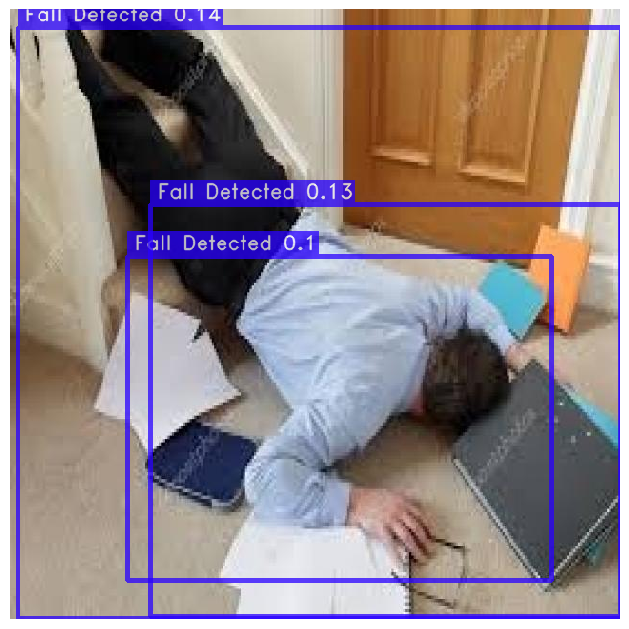

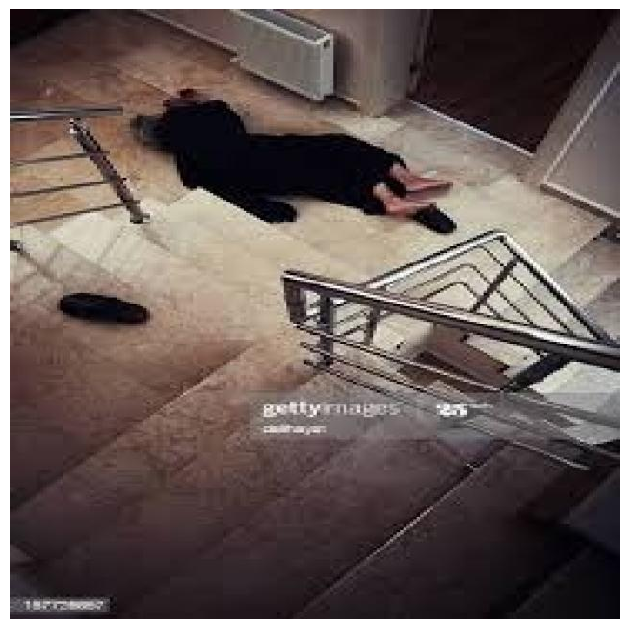

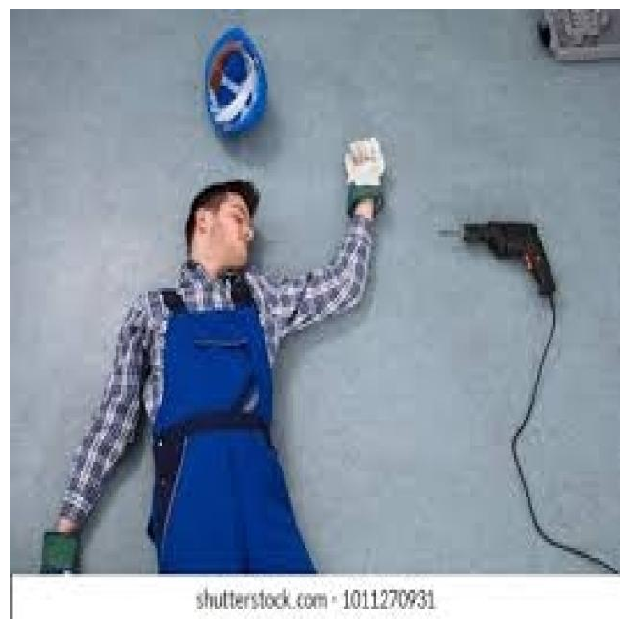

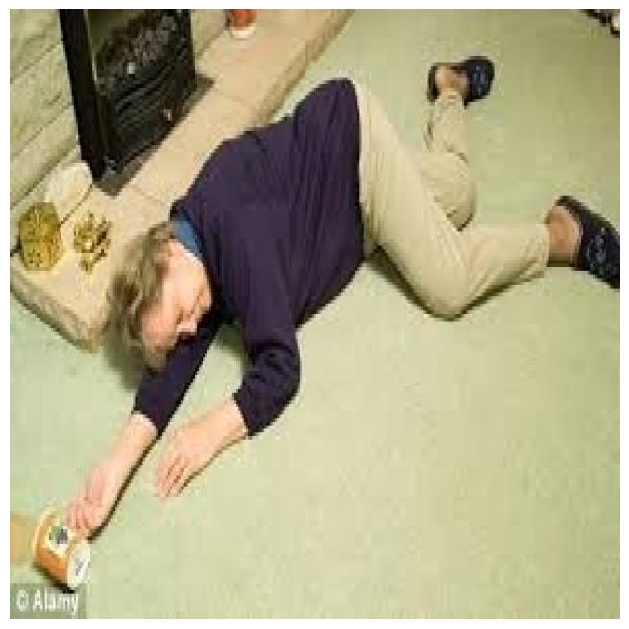

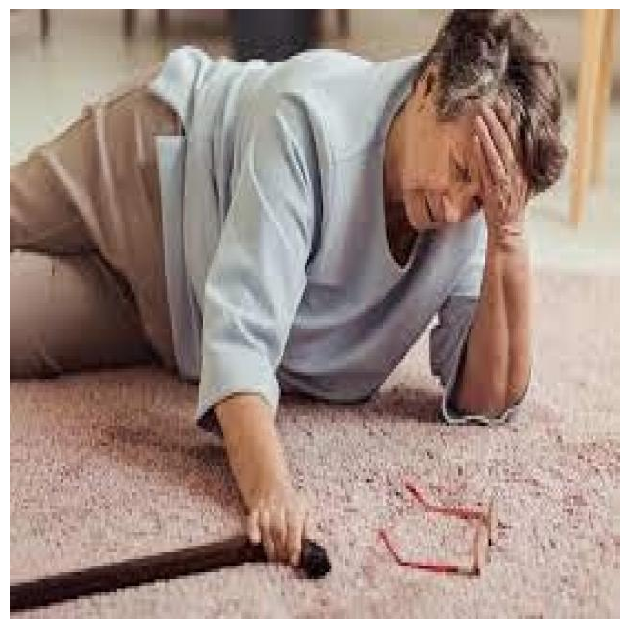

...

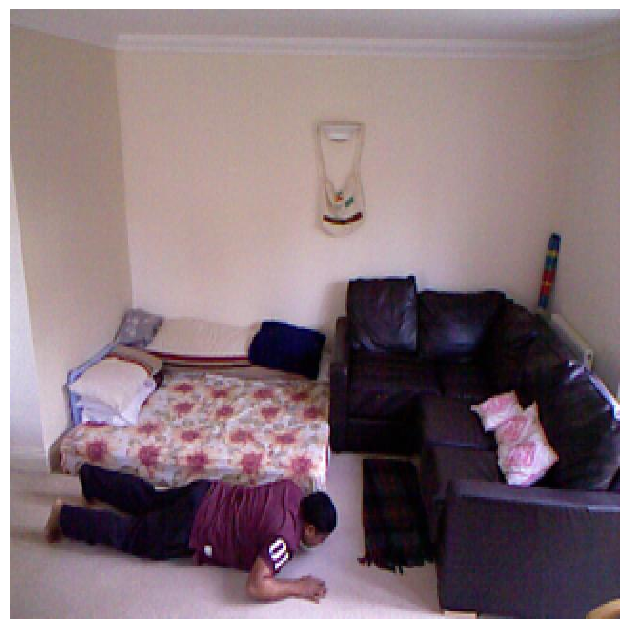

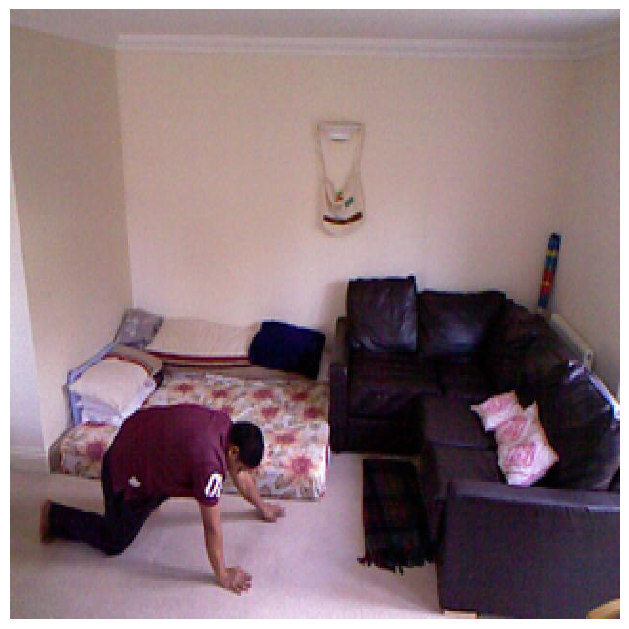

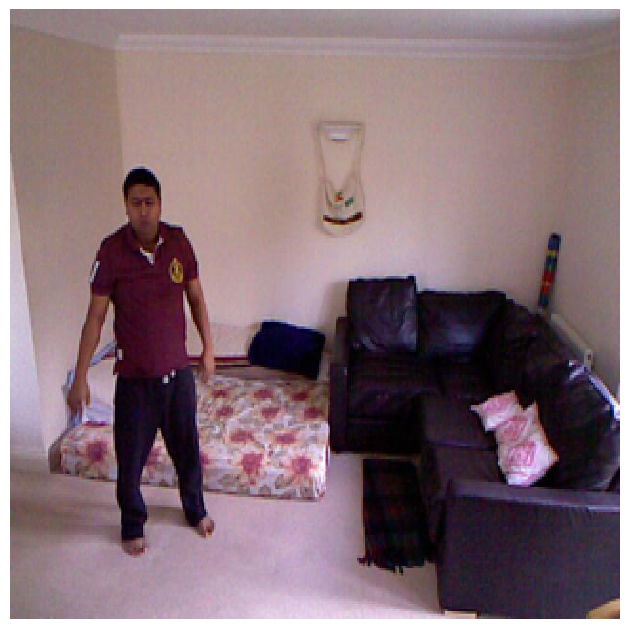

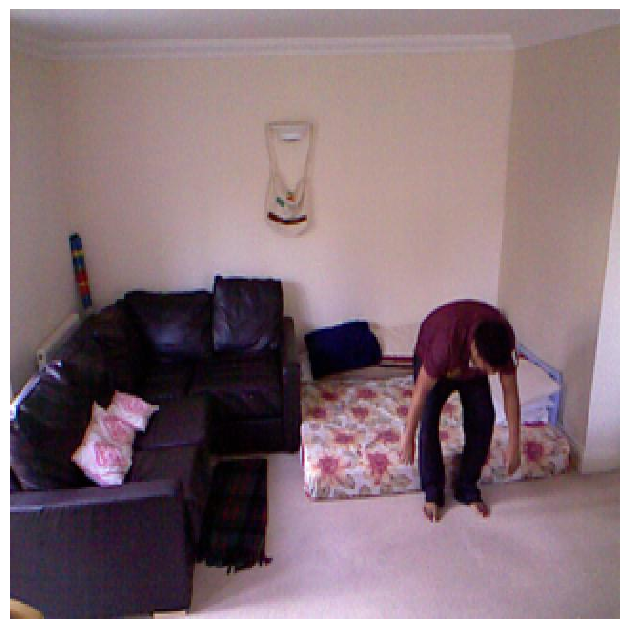

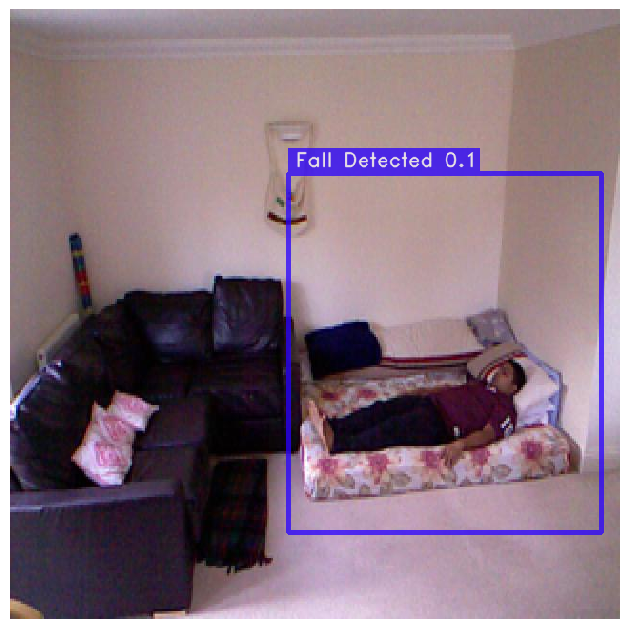

In [44]:
best_model.predict(tpaths, conf=0.1).show()